In [64]:
import rebound
import numpy as np
import matplotlib.pyplot as plt
from subprocess import call
plt.style.use('paper')
%matplotlib inline

In [67]:
sim = rebound.Simulation()
sim.add(m=1)
sim.add(m=1e-4, P=1)
sim.add(m=1e-4, P=1.2, e=0.06)
sim.move_to_com()
Nout = 1000

times = np.linspace(0, 1200, Nout)
Pratios = np.zeros(Nout)
ps = sim.particles
for i, time in enumerate(times):
    sim.integrate(time)
    Pratios[i] = ps[1].P/ps[2].P

In [83]:
def write_png(params):
    j, i, dpi = params
    fig, ax = plt.subplots(figsize=(12, 8))
    ax.plot(times[:i], Pratios[:i], '.')
    if i==572:
        ax.scatter(times[i], 1, facecolor='r')
    ax.set_ylim([0.7, 1])
    ax.set_xlim([0, 700])
    ax.set_xlabel('Time (Orbits)')
    ax.set_ylabel('Period Ratio')
    fig.savefig('tmp/{0:0=5d}.png'.format(j), transparent=True, dpi=dpi, bbox_inches='tight')
    plt.close(fig)  

In [85]:
%%time
dpi = 300.1
Lmovie = 5 # sec
fps = 30
sep = int(572/(Lmovie*fps))
idx = np.arange(0, 572, sep)
idx = list(idx)+[572]

call("rm -f tmp/*.png", shell=True)
pool = rebound.InterruptiblePool()
params = [(j, i, dpi) for j, i in enumerate(idx)]
res = pool.map(write_png, params)

CPU times: user 100 ms, sys: 89.9 ms, total: 190 ms
Wall time: 13.8 s


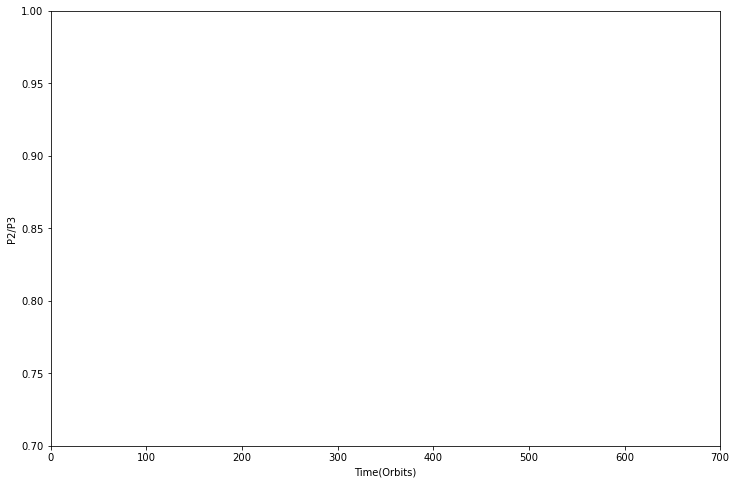

In [27]:
from IPython.display import HTML
from matplotlib import animation

tmin = times.min()
tmax = 700

fig, ax = plt.subplots(figsize=(12,8))
ax.set_xlim([tmin, tmax])
ax.set_ylim([0.7, 1])
    
tpts, = ax.plot([], [], 'bo', ms=6)
ax.set_xlabel('Time(Orbits)')
ax.set_ylabel('P2/P3')
def init():  
    tpts.set_data([], [])
    return [tpts] # must be an iterable of artists so turn into single list

def animate(i):
    global times, Pratios
    tpts.set_data(times[:i], Pratios[:i])
    return [tpts]# must be an iterable of artists so turn into single list

Nimgs=len(times)
anim = animation.FuncAnimation(fig,animate,init_func=init,frames=Nimgs,interval=100,blit=True)

In [28]:
%%time
HTML(anim.to_jshtml())

Animation size has reached 20988757 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


CPU times: user 44.5 s, sys: 747 ms, total: 45.3 s
Wall time: 45.5 s
